# Introduction 

In this project, the data will be analysed, wrangled and be used to construct different predictive models using predictive modelling and machine learning. Predictive models can be build using various predictive modelling techniques. Predictive modelling is described as the process of creating, testing and validating a model to predict future events or outcomes. It is a tool used heavily in predictive analytics which is used in many industries such as the financial industry to predict the future stock market. 

The dataset provided is about the various features of different vehicles. The dataset will be used to build various predictive models to be able predict a particular feature of a vehicle.

The outline of this project is as following:
1. Data wrangling and data inspection

2. Clustering (Unsupervised Machine Learning)

3. Classification (Supervised Machine Learning) <br>
    a. Binary Classification (Vehicle type) <br>
    b. Multi class Classification (Vehicle class)<br>
    c. Multi class Classification (Vehicle additional class)<br>

4. Conclusion <br>
    a. Random Forest Classifier
5. Kaggle Test Data Prediction 

To build the predictive model, various algorithms for predictive modelling are imported and applied in the building of the predictive models. 
Below is the algorithms used for different predictive techniques:
1. Clustering - KMeans 
2. Classification - DecisionTree and Random Forest Classifier

Before building the models, it is important to do data wrangling and data cleaning for the dataset provided as the dataset will be used to train the models. Therefore, any inconsistencies or missing value in the data should be treated appropriately. For example, outlier should be removed and replaced with the correct value and any missing values are to be filled with the appropriate value. Also, the predictive models will be visualise in the form of graphical charts to have an insight into the performance of each predictive model and for the audience to have a deeper understanding towards the predictive models constructed.

#### Importing the necessary libraries

In [1]:
conda install -c districtdatalabs yellowbrick #installing yellowbrick library


Note: you may need to restart the kernel to use updated packages.



CondaValueError: invalid package specification: #installing



In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.cluster import KMeans
import seaborn as sn
from sklearn.preprocessing import StandardScaler
from sklearn.tree import plot_tree
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import plot_confusion_matrix
from yellowbrick.classifier import ClassPredictionError
from yellowbrick.datasets import load_credit

C:\Users\candy\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:144: FutureWarning: The sklearn.metrics.classification module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.
  warnings.warn(message, FutureWarning)


#### Reading the files

In [3]:
df1 = pd.read_csv('vehicle-classifier.csv')

In [4]:
df1

,Manufacturer,Model,Vehicle_class,Vehicle_alt_class,US_vehicle_type,Engine_size (litres),Horsepower,Wheelbase,Width,Length,Height,Curb_weight,Fuel_capacity,Fuel_efficiency
0,Acura,Integra,Coupe,Sports,Passenger,1.8,140,101.2,67.3,172.4,52.6,2.639,13.2,28.0
1,Acura,TL,Sedan,NaN,Passenger,3.2,225,108.1,70.3,192.9,56.1,3.517,17.2,25.0
2,Acura,CL,Coupe,NaN,Passenger,3.2,225,106.9,70.6,192.0,54.7,3.470,17.2,26.0
3,Acura,RL,Sedan,NaN,Passenger,3.5,210,114.6,71.4,196.6,56.5,3.850,18.0,22.0
4,Audi,A4,Sedan,NaN,Passenger,1.8,150,103.0,68.2,178.0,55.7,2.998,16.4,27.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151,Volvo,V40,Sedan,NaN,Passenger,1.9,160,100.5,67.6,176.6,56.1,3.042,15.8,25.0
152,Volvo,S70,Sedan,NaN,Passenger,2.4,168,104.9,69.3,185.9,55.2,3.208,17.9,25.0
153,Volvo,V70,Sedan,NaN,Passenger,2.4,168,104.9,69.3,186.2,56.2,3.259,17.9,25.0
154,Volvo,C70,Coupe,NaN,Passenger,2.3,236,104.9,71.5,185.7,56.3,3.601,18.5,23.0


In [5]:
df1.head()

,Manufacturer,Model,Vehicle_class,Vehicle_alt_class,US_vehicle_type,Engine_size (litres),Horsepower,Wheelbase,Width,Length,Height,Curb_weight,Fuel_capacity,Fuel_efficiency
0,Acura,Integra,Coupe,Sports,Passenger,1.8,140,101.2,67.3,172.4,52.6,2.639,13.2,28.0
1,Acura,TL,Sedan,NaN,Passenger,3.2,225,108.1,70.3,192.9,56.1,3.517,17.2,25.0
2,Acura,CL,Coupe,NaN,Passenger,3.2,225,106.9,70.6,192.0,54.7,3.470,17.2,26.0
3,Acura,RL,Sedan,NaN,Passenger,3.5,210,114.6,71.4,196.6,56.5,3.850,18.0,22.0
4,Audi,A4,Sedan,NaN,Passenger,1.8,150,103.0,68.2,178.0,55.7,2.998,16.4,27.0


In [6]:
df1.shape

(156, 14)

<p style = "fontsize : medium;"> The dataframe has <strong><em>156 rows</em></strong> and <strong><em>14 columns</em></strong>.

In [7]:
df1.dtypes

Manufacturer             object
Model                    object
Vehicle_class            object
Vehicle_alt_class        object
US_vehicle_type          object
Engine_size (litres)    float64
Horsepower                int64
Wheelbase               float64
Width                   float64
Length                  float64
Height                  float64
Curb_weight             float64
Fuel_capacity           float64
Fuel_efficiency         float64
dtype: object

Among the 14 columns, 5 columns consist of ***categorical data*** and 9 columns consist of ***numerical data***.

### Data Wrangling

#### Removing duplicated data

In [8]:
duplicates = df1.duplicated(subset = ['Manufacturer','Model','Vehicle_class','Vehicle_alt_class','US_vehicle_type','Engine_size (litres)',
                        'Horsepower','Wheelbase','Width','Length','Height', 'Curb_weight','Fuel_capacity','Fuel_efficiency'])

In [9]:
df1.drop_duplicates(subset = ['Manufacturer','Model','Vehicle_class','Vehicle_alt_class','US_vehicle_type','Engine_size (litres)',
                        'Horsepower','Wheelbase','Width','Length','Height', 'Curb_weight','Fuel_capacity','Fuel_efficiency'],
                   keep = 'first', inplace = True)

In [10]:
df1

,Manufacturer,Model,Vehicle_class,Vehicle_alt_class,US_vehicle_type,Engine_size (litres),Horsepower,Wheelbase,Width,Length,Height,Curb_weight,Fuel_capacity,Fuel_efficiency
0,Acura,Integra,Coupe,Sports,Passenger,1.8,140,101.2,67.3,172.4,52.6,2.639,13.2,28.0
1,Acura,TL,Sedan,NaN,Passenger,3.2,225,108.1,70.3,192.9,56.1,3.517,17.2,25.0
2,Acura,CL,Coupe,NaN,Passenger,3.2,225,106.9,70.6,192.0,54.7,3.470,17.2,26.0
3,Acura,RL,Sedan,NaN,Passenger,3.5,210,114.6,71.4,196.6,56.5,3.850,18.0,22.0
4,Audi,A4,Sedan,NaN,Passenger,1.8,150,103.0,68.2,178.0,55.7,2.998,16.4,27.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151,Volvo,V40,Sedan,NaN,Passenger,1.9,160,100.5,67.6,176.6,56.1,3.042,15.8,25.0
152,Volvo,S70,Sedan,NaN,Passenger,2.4,168,104.9,69.3,185.9,55.2,3.208,17.9,25.0
153,Volvo,V70,Sedan,NaN,Passenger,2.4,168,104.9,69.3,186.2,56.2,3.259,17.9,25.0
154,Volvo,C70,Coupe,NaN,Passenger,2.3,236,104.9,71.5,185.7,56.3,3.601,18.5,23.0


As the number of rows and columns remained unchanged after trying to remove duplicated data , this shows that there is no duplicated data in the dataset provided.

#### Treating Missing Values
Whenever possible, the rows with missing data are not removed and is replaced with the actual value or the aggregated value for a particular group

In [11]:
df1.isna().any() #checking which columns contain missing data

Manufacturer            False
Model                   False
Vehicle_class           False
Vehicle_alt_class        True
US_vehicle_type         False
Engine_size (litres)    False
Horsepower              False
Wheelbase               False
Width                   False
Length                  False
Height                  False
Curb_weight              True
Fuel_capacity           False
Fuel_efficiency          True
dtype: bool

In [12]:
df1.isnull().sum() #finding the sum of the number of rows with missing data in each column

Manufacturer              0
Model                     0
Vehicle_class             0
Vehicle_alt_class       133
US_vehicle_type           0
Engine_size (litres)      0
Horsepower                0
Wheelbase                 0
Width                     0
Length                    0
Height                    0
Curb_weight               1
Fuel_capacity             0
Fuel_efficiency           2
dtype: int64

In [13]:
missing1 = df1[df1['Curb_weight'].isnull()]
missing1

,Manufacturer,Model,Vehicle_class,Vehicle_alt_class,US_vehicle_type,Engine_size (litres),Horsepower,Wheelbase,Width,Length,Height,Curb_weight,Fuel_capacity,Fuel_efficiency
15,Cadillac,Seville,Sedan,NaN,Passenger,4.6,275,112.2,75.0,201.0,55.4,NaN,18.5,22.0


In [14]:
df1['Curb_weight'].fillna(4.18, inplace = True)

The column ***Curb_weight*** has 1 row with missing value. The missing value is them replaced with the actual curb weight of the car that was obtained from the Internet. 

In [15]:
missing2 = df1[df1['Fuel_efficiency'].isnull()]
missing2

,Manufacturer,Model,Vehicle_class,Vehicle_alt_class,US_vehicle_type,Engine_size (litres),Horsepower,Wheelbase,Width,Length,Height,Curb_weight,Fuel_capacity,Fuel_efficiency
37,Dodge,Intrepid,Sedan,NaN,Passenger,2.7,202,113.0,74.7,203.7,55.9,3.489,17.0,NaN
108,Oldsmobile,Intrigue,Sedan,NaN,Passenger,3.5,215,109.0,73.6,195.9,56.6,3.455,18.0,NaN


In [16]:
fuel = df1.groupby('Vehicle_class').agg('Fuel_efficiency').median()

In [17]:
fuel

Vehicle_class
Coupe    24.0
MPV      22.0
SUV      19.0
Sedan    25.0
Truck    18.0
Name: Fuel_efficiency, dtype: float64

In [18]:
df1['Fuel_efficiency'].fillna(25.0, inplace = True)

The column ***Fuel_efficiency*** has 2 rows with missing values. The missing values are then replaced with the median of fuel efficiency that corresponds to their vehicle class.

In [19]:
missing3 = df1[df1['Vehicle_alt_class'].isnull()]
missing3

,Manufacturer,Model,Vehicle_class,Vehicle_alt_class,US_vehicle_type,Engine_size (litres),Horsepower,Wheelbase,Width,Length,Height,Curb_weight,Fuel_capacity,Fuel_efficiency
1,Acura,TL,Sedan,NaN,Passenger,3.2,225,108.1,70.3,192.9,56.1,3.517,17.2,25.0
2,Acura,CL,Coupe,NaN,Passenger,3.2,225,106.9,70.6,192.0,54.7,3.470,17.2,26.0
3,Acura,RL,Sedan,NaN,Passenger,3.5,210,114.6,71.4,196.6,56.5,3.850,18.0,22.0
4,Audi,A4,Sedan,NaN,Passenger,1.8,150,103.0,68.2,178.0,55.7,2.998,16.4,27.0
5,Audi,A6,Sedan,NaN,Passenger,2.8,200,108.7,71.3,188.8,57.2,3.561,18.5,22.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151,Volvo,V40,Sedan,NaN,Passenger,1.9,160,100.5,67.6,176.6,56.1,3.042,15.8,25.0
152,Volvo,S70,Sedan,NaN,Passenger,2.4,168,104.9,69.3,185.9,55.2,3.208,17.9,25.0
153,Volvo,V70,Sedan,NaN,Passenger,2.4,168,104.9,69.3,186.2,56.2,3.259,17.9,25.0
154,Volvo,C70,Coupe,NaN,Passenger,2.3,236,104.9,71.5,185.7,56.3,3.601,18.5,23.0


In [20]:
df1.loc[df1['Vehicle_alt_class'].isnull(),'Vehicle_alt_class'] = df1['Vehicle_class'] 
#Replacing the missing data in Vehicle_alt_class with the data from the column Vehicle_class according to its rows.

In [21]:
df1.describe()

,Engine_size (litres),Horsepower,Wheelbase,Width,Length,Height,Curb_weight,Fuel_capacity,Fuel_efficiency
count,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000
mean,3.060897,185.948718,107.499359,71.133974,187.301923,59.187179,3.383167,17.951923,23.858974
std,1.044653,56.700321,7.638996,3.415326,13.402491,7.922412,0.631736,3.887921,4.256985
min,1.000000,55.000000,92.600000,62.600000,149.400000,47.000000,1.895000,10.300000,15.000000
25%,2.300000,149.500000,103.000000,68.500000,177.575000,54.775000,2.973000,15.800000,21.000000
50%,3.000000,177.500000,107.000000,70.550000,187.900000,56.200000,3.355000,17.200000,24.000000
75%,3.575000,215.000000,112.200000,73.175000,196.125000,64.525000,3.821500,19.575000,26.000000
max,8.000000,450.000000,138.700000,79.900000,224.500000,104.500000,5.572000,32.000000,45.000000


#### Replacing the outlier with the correct value

An outlier was identify in the column ***Height*** as the maximum value of the column ***Height*** is 104.5 which is impossible to be the height of a car. Therefore, the outlier is replaced with the actual value of the the height of the car.

In [22]:
df1.loc[df1['Height'].idxmax()]

Manufacturer            Chevrolet
Model                    Corvette
Vehicle_class               Coupe
Vehicle_alt_class          Sports
US_vehicle_type         Passenger
Engine_size (litres)          5.7
Horsepower                    345
Wheelbase                   104.5
Width                        73.6
Length                      179.7
Height                      104.5
Curb_weight                  3.21
Fuel_capacity                19.1
Fuel_efficiency                22
Name: 24, dtype: object

In [23]:
df1.at[24, 'Height'] = 48.6 #Replacing with the actual height of the vehicle

### Basic Statistics

In [24]:
df1.describe()

,Engine_size (litres),Horsepower,Wheelbase,Width,Length,Height,Curb_weight,Fuel_capacity,Fuel_efficiency
count,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000
mean,3.060897,185.948718,107.499359,71.133974,187.301923,58.828846,3.383167,17.951923,23.858974
std,1.044653,56.700321,7.638996,3.415326,13.402491,7.078965,0.631736,3.887921,4.256985
min,1.000000,55.000000,92.600000,62.600000,149.400000,47.000000,1.895000,10.300000,15.000000
25%,2.300000,149.500000,103.000000,68.500000,177.575000,54.700000,2.973000,15.800000,21.000000
50%,3.000000,177.500000,107.000000,70.550000,187.900000,56.150000,3.355000,17.200000,24.000000
75%,3.575000,215.000000,112.200000,73.175000,196.125000,63.950000,3.821500,19.575000,26.000000
max,8.000000,450.000000,138.700000,79.900000,224.500000,83.600000,5.572000,32.000000,45.000000


In [25]:
df1['Engine_size (litres)'].describe()

count    156.000000
mean       3.060897
std        1.044653
min        1.000000
25%        2.300000
50%        3.000000
75%        3.575000
max        8.000000
Name: Engine_size (litres), dtype: float64

***Engine_size(litres)*** is the size of the engine of the car in litre. The minimum, first quartile, median, third quartile, maximum for ***Engine_size (litres)*** are *1.0, 2.3, 3.0, 3.575, 8.0* respectively

In [26]:
df1['Horsepower'].describe()

count    156.000000
mean     185.948718
std       56.700321
min       55.000000
25%      149.500000
50%      177.500000
75%      215.000000
max      450.000000
Name: Horsepower, dtype: float64

***Horsepower*** is the power of the the engine. The minimum, first quartile, median, third quartile, maximum for ***Horsepower*** are *55.0, 149.5, 177.5, 215.0, 450.0* respectively.

In [27]:
df1['Wheelbase'].describe()

count    156.000000
mean     107.499359
std        7.638996
min       92.600000
25%      103.000000
50%      107.000000
75%      112.200000
max      138.700000
Name: Wheelbase, dtype: float64

***Wheelbase*** is the distance between the the centers of the front wheel and rear wheel. The minimum, first quartile, median, third quartile, maximum for ***Wheelbase*** are *92.6, 103.0, 107.0, 112.0, 138.7* respectively.

In [28]:
df1['Width'].describe()

count    156.000000
mean      71.133974
std        3.415326
min       62.600000
25%       68.500000
50%       70.550000
75%       73.175000
max       79.900000
Name: Width, dtype: float64

***Width*** is the width of the car. The minimum, first quartile, median, third quartile, maximum for ***Width*** are *62.6, 68.5, 70.55, 73.175 and 79.9* respectively

In [29]:
df1['Length'].describe()

count    156.000000
mean     187.301923
std       13.402491
min      149.400000
25%      177.575000
50%      187.900000
75%      196.125000
max      224.500000
Name: Length, dtype: float64

***Length*** is the length of the car. The minimum, first quartile, median, third quartile, maximum for ***Length*** are *149.4, 177.575, 187.9, 196.125and 224.5* respectively.

In [30]:
df1['Height'].describe()

count    156.000000
mean      58.828846
std        7.078965
min       47.000000
25%       54.700000
50%       56.150000
75%       63.950000
max       83.600000
Name: Height, dtype: float64

***Height*** is the height of the car. The minimum, first quartile, median, third quartile, maximum for ***Height*** are *47.0, 54.7, 56.15, 63.95 and 83.6* respectively. 

In [31]:
df1['Curb_weight'].describe()

count    156.000000
mean       3.383167
std        0.631736
min        1.895000
25%        2.973000
50%        3.355000
75%        3.821500
max        5.572000
Name: Curb_weight, dtype: float64

***Curb_weight*** is the weight of the car without occupants and baggage or load. The minimum, first quartile, median, third quartile, maximum for ***Curb_weight*** is *1.895, 2.973, 3.355, 3.8215, 5.572* respectively 

In [32]:
df1['Fuel_capacity'].describe()

count    156.000000
mean      17.951923
std        3.887921
min       10.300000
25%       15.800000
50%       17.200000
75%       19.575000
max       32.000000
Name: Fuel_capacity, dtype: float64

***Fuel_capacity*** is the capacity of the fuel tank of the car in litres. The minimum, first quartile, median, third quartile, maximum for ***Fuel_capacity*** are *10.3, 15.8, 17.2, 19.575 and 32.0*.

In [33]:
df1['Fuel_efficiency'].describe()

count    156.000000
mean      23.858974
std        4.256985
min       15.000000
25%       21.000000
50%       24.000000
75%       26.000000
max       45.000000
Name: Fuel_efficiency, dtype: float64

***Fuel_efficiency*** is the ratio of the amounf of fuel used to the amount of distance travelled. The minimum, first quartile, median, third quartile, maximum for *15.0, 21.0, 24.0, 26.0, 45.0*.

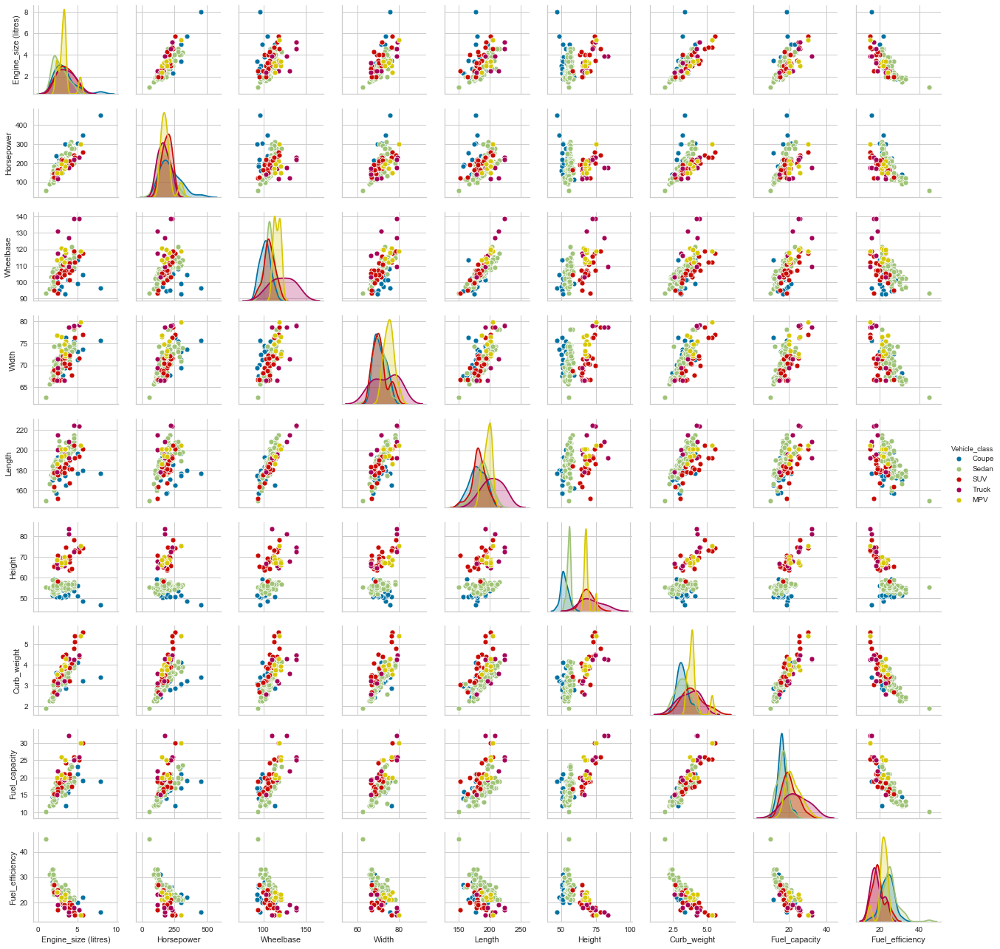

In [34]:
sn.pairplot(df1, hue='Vehicle_class', height=2) #creating scatter plot for all variables 

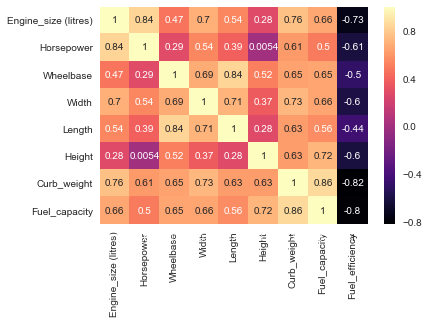

In [35]:
#creating a heatmap for the correlation matrix
corr = df1.corr()
ax = sn.heatmap(corr, annot=True, cmap = 'magma')
ax.set_ylim(8.0, 0)
plt.show()

## Clustering 

*Clustering* is one of the most commonly used methods of unsupervised machine learning. ***Unsupervised machine learning*** is a type of machine learning that draw conclusion from dataset consisting input data without any labelled data or labelled response.
The main purpose of unsupervised machine learning is to *identify hidden patterns or information* in the dataset in order to have a deeper insight and understanding about the data and to extract useful information from it. It is called unsupervised machine learning because the model is not 'supervise' or being 'teach' as the model do not have the output to the input given and there is no training or teseting the model but it is left on its own to discover the patterns in the data. Often, clustering is used to perform this objective.

Clustering works by grouping data with similiar features into different groups or clusters to identify the patterns of the clusters. For example, clustering is often used in marketting to group customers into different clusters based on their buying preferences which can help the company to plan marketting strategies towards a particular group of consumers. 

Clustering is used in this project to group different vehicle into various clusters according to their features to find the pattern of different features of different vehicles.

In [36]:
df2 = df1.drop(columns = ['Vehicle_class', 'Vehicle_alt_class', 'US_vehicle_type'])

In [37]:
df2

,Manufacturer,Model,Engine_size (litres),Horsepower,Wheelbase,Width,Length,Height,Curb_weight,Fuel_capacity,Fuel_efficiency
0,Acura,Integra,1.8,140,101.2,67.3,172.4,52.6,2.639,13.2,28.0
1,Acura,TL,3.2,225,108.1,70.3,192.9,56.1,3.517,17.2,25.0
2,Acura,CL,3.2,225,106.9,70.6,192.0,54.7,3.470,17.2,26.0
3,Acura,RL,3.5,210,114.6,71.4,196.6,56.5,3.850,18.0,22.0
4,Audi,A4,1.8,150,103.0,68.2,178.0,55.7,2.998,16.4,27.0
...,...,...,...,...,...,...,...,...,...,...,...
151,Volvo,V40,1.9,160,100.5,67.6,176.6,56.1,3.042,15.8,25.0
152,Volvo,S70,2.4,168,104.9,69.3,185.9,55.2,3.208,17.9,25.0
153,Volvo,V70,2.4,168,104.9,69.3,186.2,56.2,3.259,17.9,25.0
154,Volvo,C70,2.3,236,104.9,71.5,185.7,56.3,3.601,18.5,23.0


Height and Horsepower are chosen as the input as they are the least correlated variables and the data points are widely dispersed on the scatter plot. Therefore, clustering the variables may show a hidden pattern and additional information.

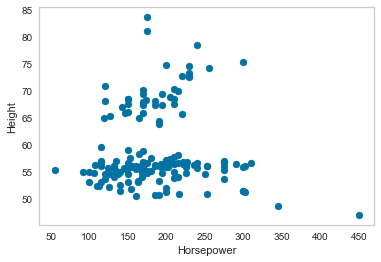

In [38]:
plt.scatter(x = df2['Horsepower'], y = df2['Height'])
plt.xlabel('Horsepower')
plt.ylabel('Height')
plt.grid(None)
plt.show()

In [39]:
kmeans1 = KMeans(n_clusters=2).fit(
    df2[['Horsepower', 'Height']]
)

In [40]:
# Look at the outputs: Two cluster centers
kmeans1.cluster_centers_
# Look at the outputs: Cluster labels
kmeans1.labels_

array([0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0,
       0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1,
       0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0,
       1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0,
       1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 1])

In [41]:
LABEL_COLOR_MAP = {0 : 'r',
                   1 : 'k',
                   }

label_color = [LABEL_COLOR_MAP[l] for l in kmeans1.labels_]

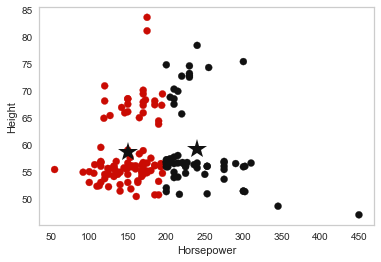

In [42]:
# Visualise the output labels
plt.scatter(
x=df2['Horsepower'],
y=df2['Height'],
c=label_color
)
# Visualise the cluster centers (black stars)
plt.plot(
kmeans1.cluster_centers_[:,0],
kmeans1.cluster_centers_[:,1],
'k*',
markersize=20,
)
plt.grid(None)
plt.xlabel('Horsepower')
plt.ylabel('Height')
plt.show()

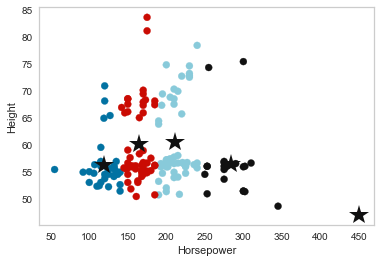

In [43]:
# Run K-means with another K value
# Set K=5: we want to cluster the dataset into five subgroups
kmeans2 = KMeans(n_clusters=5).fit(
df2[['Horsepower','Height']]
)
# different color for each cluster
LABEL_COLOR_MAP = {0 : 'r',
                   1 : 'k',
                   2 : 'b',
                   3 : 'c',
                   4 : 'm'
                   }

label_color = [LABEL_COLOR_MAP[l] for l in kmeans2.labels_]
# Visualise the output labels
plt.scatter(
x=df2['Horsepower'],
y=df2['Height'],
c=label_color
)
# Visualise the cluster centers (black stars)
plt.plot(
kmeans2.cluster_centers_[:,0],
kmeans2.cluster_centers_[:,1],
'k*',
markersize=20
)
plt.grid(None)
plt.xlabel('Horsepower')
plt.ylabel('Height')
plt.show()

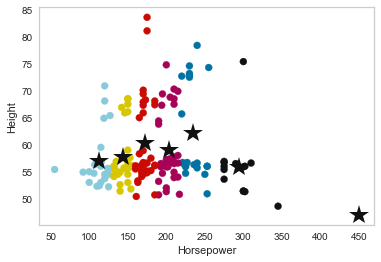

In [44]:
# Run K-means with another K value
# Set K=7: we want to cluster the dataset into seven subgroups
kmeans3 = KMeans(n_clusters=7).fit(
df2[['Horsepower','Height']]
)

LABEL_COLOR_MAP = {0 : 'r',
                   1 : 'k',
                   2 : 'b',
                   3 : 'c',
                   4 : 'm',
                   5 : 'g',
                   6 : 'y'
                   }

label_color = [LABEL_COLOR_MAP[l] for l in kmeans3.labels_]
# Visualise the output labels
plt.scatter(
x=df2['Horsepower'],
y=df2['Height'],
c=label_color
)
# Visualise the cluster centers (black stars)
plt.plot(
kmeans3.cluster_centers_[:,0],
kmeans3.cluster_centers_[:,1],
'k*',
markersize=20
)
plt.grid(None)
plt.xlabel('Horsepower')
plt.ylabel('Height')
plt.show()

After running kMeans with different number of clusters to estimate the actual number of clusters in the data, it is most likely that the data contains 5 clusters, the clusters and centroids are more distinct from each other and have a more obvious pattern compared to running with 2 or 7 clusters. Based on the graph, the clusters are partitioned by the horsepower of the vehicle and the centroid have almost the same height value. The relationship between the height and horsepower is difficult to derive as there are little changes in the location of the centroids in terms of the height variable. Most of the clusters and centroids are closely located to each other and different clusters shared the some similiarity in the height.  Therefore, a new predictive model for clustering is constructed using an improved set of input.

#### Using different variables for clustering

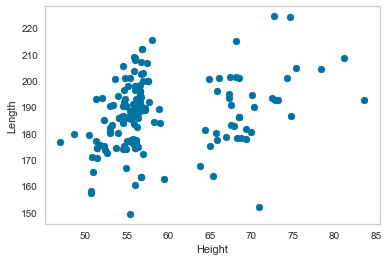

In [45]:
plt.scatter(x = df2['Height'], y = df2['Length'])
plt.xlabel('Height')
plt.ylabel('Length')
plt.grid(None)
plt.show()

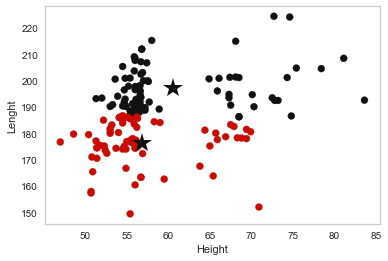

In [46]:
kmeans4 = KMeans(n_clusters=2).fit(
    df2[['Height', 'Length']]
)
# different color for each cluster
LABEL_COLOR_MAP = {0 : 'r',
                   1 : 'k'
                   }
label_color = [LABEL_COLOR_MAP[l] for l in kmeans4.labels_]
# Visualise the output labels
plt.scatter(
x=df2['Height'],
y=df2['Length'],
c=label_color
)
# Visualise the cluster centers (black stars)
plt.plot(
kmeans4.cluster_centers_[:,0],
kmeans4.cluster_centers_[:,1],
'k*',
markersize=20,
)
plt.grid(None)
plt.xlabel('Height')
plt.ylabel('Lenght')
plt.show()

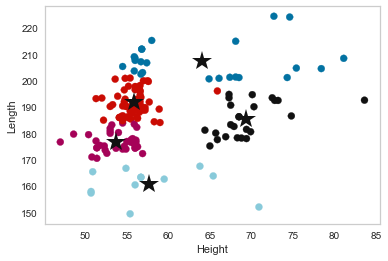

In [47]:
kmeans4 = KMeans(n_clusters=5).fit(
    df2[['Height', 'Length']]
)
# different color for each cluster
LABEL_COLOR_MAP = {0 : 'r',
                   1 : 'k',
                   2 : 'b',
                   3 : 'c',
                   4 : 'm'
                   }
label_color = [LABEL_COLOR_MAP[l] for l in kmeans4.labels_]
# Visualise the output labels
plt.scatter(
x=df2['Height'],
y=df2['Length'],
c=label_color
)
# Visualise the cluster centers (black stars)
plt.plot(
kmeans4.cluster_centers_[:,0],
kmeans4.cluster_centers_[:,1],
'k*',
markersize=20,
)
plt.grid(None)
plt.xlabel('Height')
plt.ylabel('Length')
plt.show()

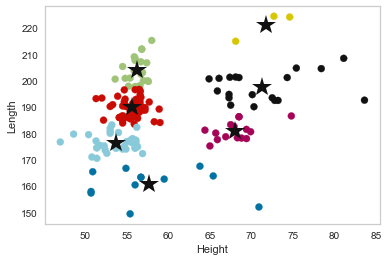

In [48]:
kmeans4 = KMeans(n_clusters=7).fit(
    df2[['Height', 'Length']]
)
# different color for each cluster
LABEL_COLOR_MAP = {0 : 'r',
                   1 : 'k',
                   2 : 'b',
                   3 : 'c',
                   4 : 'm',
                   5 : 'g',
                   6 : 'y'
                   }
label_color = [LABEL_COLOR_MAP[l] for l in kmeans4.labels_]
# Visualise the output labels
plt.scatter(
x=df2['Height'],
y=df2['Length'],
c=label_color
)
# Visualise the cluster centers (black stars)
plt.plot(
kmeans4.cluster_centers_[:,0],
kmeans4.cluster_centers_[:,1],
'k*',
markersize=20,
)
plt.grid(None)
plt.xlabel('Height')
plt.ylabel('Length')
plt.show()

This is a better model because the centroids and clusters are not located as close as the previous model. Thus, it is easier to distinguish the featuress of each cluster. For this model, it is most likely that the data contains 5 clusters. Most vehicle has a height of 50 to 60. In most case, a greater height is associated with a greater length with some exception where an increase in height does not relate to an increase in length.

## Classification

a. There are 2 types of classification available which are known as ***binary classification*** and ***multi-class classification***. Binary classification can only take up to ***2 categories*** for the labelled data and classify the unseen instances into one of two classses. On the other hand, multi class classification can take labelled data with ***more than 2 categories*** and classify unseen instance into one of its many categories. Binary classification will only results in 2 different outputs whereas multi class classification can results in more than 2 different outputs.

b. ***Classification*** is an example of ***supervised machine learning***. In supervised machine learning, predictive models are build by learning from examples using historical data from the training dataset. In details, the model is exposed to ***training dataset*** that consists of inputs that are paired with the correct outputs which is also called the ***labelled data***. ***Labelled data*** is the output or response to the input data. The algorithm of the model will use the data to identify patterns or correlation between the input data and labelled data. The model will then be able to forecast future instances after being trained.

In this task, the ***decision tree algorithm*** will be used to build a classification model. To build the model, we need to first choose the input data which is data or the feature that is going to be used to train the model and the labelled data which is output data. The data is then spilt into ***the training data and test data*** where the proportion of training data must be larger than the test data. The test data should not have a big proportion of data as it is only used for testing the data. Most data should be reserved as training data to train the model.

***Training data*** is going to be used to train the model while the ***test data*** will not be used to train the model and is an unseen data to the model. ***Test data*** is used to evaluate the performance of our model to have an insight into the extend where the model can give a correct prediction. After the model is trained, the model will be tested with the test data by predicting the output for the test data. The *predicted output will then be compared with the actual output* of the test data to find the number of instances that are predicted correctly and wrongly to evaluate its performance. Without testing the model with the test data, it is unclear that how the model performs . Thus, test data is needed so that the model can be improved after the evaluation and gives a more accurate results.

The ***confusion matrix*** is used to evaluate the performance of the models by calculating the ***accuracy, precision, recall and f1-score***. 

***Accuracy*** is the *sum of the number of true positive and true negative divided by the total number of sample*. Accuracy should be as high as possible but there could be bias in the results when there exists an imbalanced sample in each classes. Therefore, it is important to calculate the precision and recall to have a full insight into the performance of the model.

***Precision*** is the *number of true postive divided by the sum of number of true positive and false positive*, Precision should be as high as possible as a high precision indicats there is a small number of false positive case and the instances that are predicted as true are indeed true.

***Recall*** is the *number of true positive divided by the sum of true positive and false negative*. Recall should be as high as possible as high recall indicates there is a small number of false negative.

***F1-score*** is the *measure of both recall and precision*. F-measure is needed when there exists a high recall and low precision or vice versa as it is hard to compare both of them. F-measure works by using Harmonic Mean in place of Arithmetic Mean by punishing the extreme values more. 

An ideal model should have high accuracy, high precision, high recall and high f1-score, but it is almost impossible to build a perfect model like this and often we do not get model that is high in all perspective which coordinates with the *No Free Lunch Theorem* by *David Wolpert and William Macready*.

*The result of the prediction will then be output into a csv file.*

<p style = "font-size : medium;"><strong><em>Task 3(a) :</em></strong> Binary Classification (labelled data = Vehicle_type)

In [49]:
x = df1.iloc[:,[10]].values #Input Data : Height
y = df1.iloc[:,4].values # Labelled Data : Vehicle_type

In [50]:
x_train, x_test, y_train, y_test = train_test_split(
    x, y, test_size = 0.25, random_state = 0
)

In [51]:
#Feature Scaling
sc = StandardScaler()
x_train = sc.fit_transform(x_train)
x_test = sc.transform(x_test)

In [52]:
#Fitting Decision Tree Classification to the Training Set
classifier = DecisionTreeClassifier(
    criterion = 'entropy', random_state = 0
)
classifier.fit(x_train, y_train)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=0, splitter='best')

In [53]:
#Predicting the test set results
y_pred = classifier.predict(x_test)

In [54]:
# Making the Confusion Matrix
cm = confusion_matrix(y_test, y_pred)
cm

array([[10,  0],
       [ 0, 29]], dtype=int64)

In [55]:
classification_report(y_test, y_pred,output_dict=True)

{'Car': {'precision': 1.0, 'recall': 1.0, 'f1-score': 1.0, 'support': 10},
 'Passenger': {'precision': 1.0,
  'recall': 1.0,
  'f1-score': 1.0,
  'support': 29},
 'accuracy': 1.0,
 'macro avg': {'precision': 1.0,
  'recall': 1.0,
  'f1-score': 1.0,
  'support': 39},
 'weighted avg': {'precision': 1.0,
  'recall': 1.0,
  'f1-score': 1.0,
  'support': 39}}

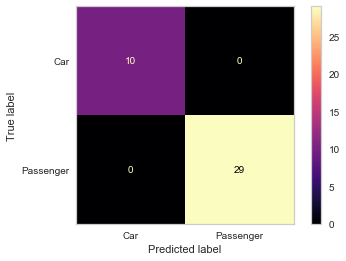

In [56]:
plot_confusion_matrix(classifier , x_test, y_test, cmap = 'magma')  
plt.grid(None)
plt.show()

The ***accuracy, precision, recall and f1-score*** are *1.0* which means all instances are classify into the correct class and there is no mistakes *(no false negative and false positive)* in the classification which indicates this is a good model.

In [57]:
#Outputting the results into a csv file
lst1 = list(range(1,len(x_test)+1))
res1 = {'Id' : lst1 , 'Predicted' : y_pred}
df5 = pd.DataFrame(res1)  
df5.to_csv('Q3C.csv', index = False) 

[Text(193.75, 283.125, 'Height <= 0.397\nentropy = 0.821\nsamples = 117\nvalue = [30, 87]\nclass = Car'),
 Text(96.875, 94.375, 'entropy = 0.0\nsamples = 87\nvalue = [0, 87]\nclass = Car'),
 Text(290.625, 94.375, 'entropy = 0.0\nsamples = 30\nvalue = [30, 0]\nclass = Passenger')]

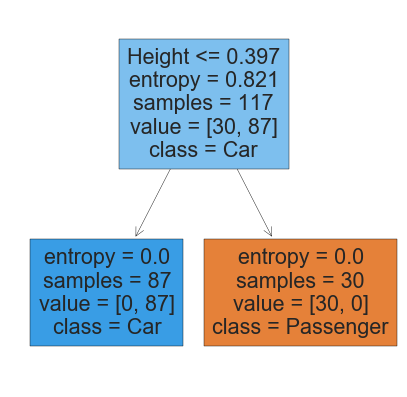

In [58]:
#Visualising the decision tree
fn=[ 'Height']
cn=[ 'Passenger', 'Car']
fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (5,5), dpi=100)
plot_tree(classifier,
               feature_names = fn, 
               class_names=cn,
               filled = True)

The tree graph shows the algorithm of the decision tree classifier and how it classify instances into classes based on the input data. If the height of the car is less than or equals to 0.397, the vehicle is classified as a car type vehicle. Otherwise, the vehicle will be classified as a passenger type vehicle.

C:\Users\candy\Anaconda3\lib\site-packages\sklearn\base.py:197: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


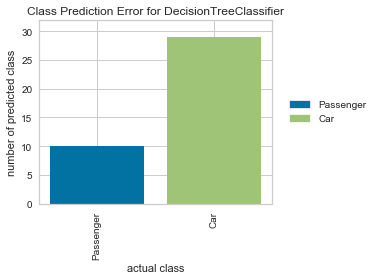

In [59]:
# Instantiate the classification model and visualizer
classes = ['Passenger','Car']
visualizer = ClassPredictionError(classifier, classes=classes)

# Fit the training data to the visualizer
visualizer.fit(x_train, y_train)

# Evaluate the model on the test data
visualizer.score(x_test, y_test)

# Draw visualization
visualizer.show()

The graph above is a class prediction error graph that shows the number of instances that are classify correctly into its class or otherwise. As shown in the graph, the model has predicted the vehicle type correctly for all inputs. Therefore, this model is a good model in classifying vehicles into its respective vehicle type. 

### Multi-class Classification
<p style = "font-size : medium;"><strong><em>Task 3(b): labelled data = Vehicle_class </em></strong> <br>

***Feature engineering*** is used in this classification model to provide new features of a vehicle that can help to train the model better and predict different classes of vehicles with a better accuracy, recall and precision.

The training dataset and test dataset have a ratio of 85:15. A big sample size of the training dataset can help to train the model to be better and have a more accurate results. 

In [60]:
df1['Power Ouptut per litre'] = df1['Horsepower']/df1['Engine_size (litres)']

In [61]:
df1['Total distance Travelled'] = df1['Fuel_capacity'] * df1['Fuel_efficiency']

In [62]:
df1['Volume'] = df1['Width'] * df1['Length'] * df1['Height']

In [63]:
x1 = df1.iloc[:,[6,7,8,9,10,11,14,15,16]].values 
#Input Data : Horsepower, Wheelbase, Width,Length, Height, Curb Weight, 
#Power Output per litre, Total distance travelled, Volume
y1 = df1.iloc[:,2].values # Labelled Data : Vehicle Class

In [64]:
#Splitting the dataset into training datset and test dataset
x1_train, x1_test, y1_train, y1_test = train_test_split(
    x1, y1, test_size = 0.15, random_state = 0
)

In [65]:
#Feature Scaling
sc = StandardScaler()
x1_train = sc.fit_transform(x1_train)
x1_test = sc.transform(x1_test)

In [66]:
classifier1 = DecisionTreeClassifier(
    criterion = 'entropy', random_state = 0
)
classifier1.fit(x1_train, y1_train)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=0, splitter='best')

In [67]:
#Predicting the test set results
y1_pred = classifier1.predict(x1_test)

In [68]:
#Outputting the results into a csv file
lst2 = list(range(1,len(x1_test)+1))
res2 = {'Id' : lst2 , 'Predicted' : y1_pred}
df5 = pd.DataFrame(res2)  
df5.to_csv('Q3d.csv', index = False) 

In [69]:
cm1 = confusion_matrix(y1_test, y1_pred)
cm1

array([[ 2,  0,  0,  1,  0],
       [ 0,  3,  0,  0,  0],
       [ 0,  0,  2,  0,  0],
       [ 0,  0,  0, 13,  0],
       [ 0,  0,  2,  0,  1]], dtype=int64)

In [70]:
classification_report(y1_test, y1_pred,output_dict=True)

{'Coupe': {'precision': 1.0,
  'recall': 0.6666666666666666,
  'f1-score': 0.8,
  'support': 3},
 'MPV': {'precision': 1.0, 'recall': 1.0, 'f1-score': 1.0, 'support': 3},
 'SUV': {'precision': 0.5,
  'recall': 1.0,
  'f1-score': 0.6666666666666666,
  'support': 2},
 'Sedan': {'precision': 0.9285714285714286,
  'recall': 1.0,
  'f1-score': 0.962962962962963,
  'support': 13},
 'Truck': {'precision': 1.0,
  'recall': 0.3333333333333333,
  'f1-score': 0.5,
  'support': 3},
 'accuracy': 0.875,
 'macro avg': {'precision': 0.8857142857142858,
  'recall': 0.8,
  'f1-score': 0.7859259259259259,
  'support': 24},
 'weighted avg': {'precision': 0.9196428571428571,
  'recall': 0.875,
  'f1-score': 0.8646604938271606,
  'support': 24}}

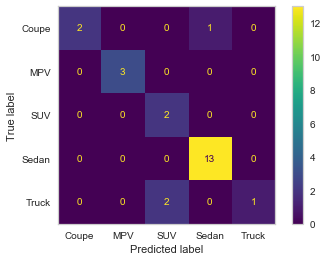

In [71]:
plot_confusion_matrix(classifier1 , x1_test, y1_test, cmap = 'viridis')  
plt.grid(None)
plt.show()

The ***accuracy*** for this classifier is *0.875*, weighted averaged ***precision,recall and f1-score*** of this classifier are *0.92, 0.875 and 0.865*. The accuracy, precision, recall and f1-score are all considerably high which means most instances are classified into the correct class. There exists some cases of false negative and false positive in certain classes but it is not significant to the overall performance of the model. Therefore, the performance of the model is considered as good.

In [72]:
fn=['Horsepower', 'Wheelbase', 'Width' ,'Length','Height', 'Curb_weight', 'Power Output per litre', 
    'Total distance Travelled', 'Volume']
cn=['Coupe', 'MPV', 'SUV', 'Sedan', 'Truck']
fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (20,20), dpi=1000)
plot_tree(classifier1,
               feature_names = fn, 
               class_names=cn,
               filled = True, fontsize = 6)

[Text(8539.35185185185, 14345.0, 'Height <= 0.44\nentropy = 1.736\nsamples = 132\nvalue = [24, 7, 21, 75, 5]\nclass = Sedan'),
 Text(3874.9999999999995, 12835.0, 'Height <= -0.962\nentropy = 0.872\nsamples = 100\nvalue = [24, 0, 1, 75, 0]\nclass = Sedan'),
 Text(3300.9259259259256, 11325.0, 'entropy = 0.0\nsamples = 12\nvalue = [12, 0, 0, 0, 0]\nclass = Coupe'),
 Text(4449.074074074074, 11325.0, 'Height <= -0.664\nentropy = 0.662\nsamples = 88\nvalue = [12, 0, 1, 75, 0]\nclass = Sedan'),
 Text(1148.148148148148, 9815.0, 'Horsepower <= -1.015\nentropy = 0.996\nsamples = 13\nvalue = [6, 0, 0, 7, 0]\nclass = Sedan'),
 Text(574.074074074074, 8305.0, 'entropy = 0.0\nsamples = 5\nvalue = [0, 0, 0, 5, 0]\nclass = Sedan'),
 Text(1722.2222222222222, 8305.0, 'Length <= -0.085\nentropy = 0.811\nsamples = 8\nvalue = [6, 0, 0, 2, 0]\nclass = Coupe'),
 Text(1148.148148148148, 6795.0, 'entropy = 0.0\nsamples = 4\nvalue = [4, 0, 0, 0, 0]\nclass = Coupe'),
 Text(2296.296296296296, 6795.0, 'Volume <= -0

Above is the visualisation of the decision tree.
As the tree size is too big and the wording is too small which are due to a large number of depths, it is hard to analyse or to have a clear insight of the classification model algorithm. Thus, a bar chart on the class prediction error is used to visualise the performance of the classification model. <br>
**Note that as the labelled data consists of many different category, the code will take a long time to run to show the graph*

C:\Users\candy\Anaconda3\lib\site-packages\sklearn\base.py:197: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


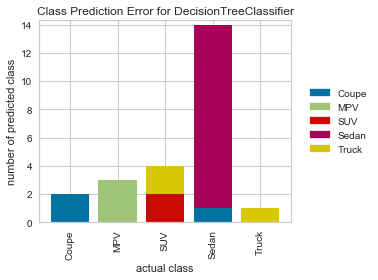

In [73]:
# Instantiate the classification model and visualizer
classes = ['Coupe', 'MPV', 'SUV', 'Sedan', 'Truck']
visualizer = ClassPredictionError(classifier1, classes=classes)

# Fit the training data to the visualizer
visualizer.fit(x1_train, y1_train)

# Evaluate the model on the test data
visualizer.score(x1_test, y1_test)

# Draw visualization
visualizer.show()

Based on the graph above, the classification model mostly predict the cars correctly according to its vehicle class. However, this classifier often mistakes Truck as SUV and Coupe as Sedan. This causes the precision and recall to decrease slightly but as the the number of false positive and false negative is significantly lower than the true positive and true negative, the model is an overall good model in predicting the vehicle class of a car.

<p style = "font-size : medium;"><strong><em>Task 3(c): Labelled data = Vehicle_alt_class </em></strong> 

In [74]:
x2 = df1.iloc[:,[6,10,11,16]].values #Input Data : #Horsepower, Height, Curb Weight, Volume
y2 = df1.iloc[:,3].values # Labelled Data : Vehicle_alt_class

In [75]:
x2_train, x2_test, y2_train, y2_test = train_test_split(
    x2, y2, test_size = 0.2, random_state = 0
)

In [76]:
#Feature Scaling
sc = StandardScaler()
x2_train = sc.fit_transform(x2_train)
x2_test = sc.transform(x2_test)

In [77]:
classifier2 = DecisionTreeClassifier(
    criterion = 'entropy', random_state = 0
)
classifier2.fit(x2_train, y2_train)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=0, splitter='best')

In [78]:
#Predicting the test set results
y2_pred = classifier2.predict(x2_test)

In [79]:
#Outputting the results into csv file
# dictionary of lists
lst3 = list(range(1,len(x2_test)+1))
res3 = { 'Id' : lst3, 'Predicted': y2_pred}
  
df6 = pd.DataFrame(res3) 
  
# saving the dataframe 
df6.to_csv('file3.csv', index = False) 

In [80]:
cm2 = confusion_matrix(y2_test, y2_pred)
cm2

array([[ 1,  0,  0,  0,  0,  0,  0],
       [ 0,  1,  0,  0,  0,  0,  0],
       [ 0,  0,  3,  0,  0,  0,  0],
       [ 0,  0,  0,  4,  0,  0,  0],
       [ 0,  0,  0,  0, 16,  0,  0],
       [ 0,  0,  0,  0,  1,  3,  0],
       [ 0,  0,  0,  2,  0,  0,  1]], dtype=int64)

In [81]:
classification_report(y2_test, y2_pred,output_dict=True)

{'Coupe': {'precision': 1.0, 'recall': 1.0, 'f1-score': 1.0, 'support': 1},
 'Hatch': {'precision': 1.0, 'recall': 1.0, 'f1-score': 1.0, 'support': 1},
 'MPV': {'precision': 1.0, 'recall': 1.0, 'f1-score': 1.0, 'support': 3},
 'SUV': {'precision': 0.6666666666666666,
  'recall': 1.0,
  'f1-score': 0.8,
  'support': 4},
 'Sedan': {'precision': 0.9411764705882353,
  'recall': 1.0,
  'f1-score': 0.9696969696969697,
  'support': 16},
 'Sports': {'precision': 1.0,
  'recall': 0.75,
  'f1-score': 0.8571428571428571,
  'support': 4},
 'Truck': {'precision': 1.0,
  'recall': 0.3333333333333333,
  'f1-score': 0.5,
  'support': 3},
 'accuracy': 0.90625,
 'macro avg': {'precision': 0.9439775910364145,
  'recall': 0.869047619047619,
  'f1-score': 0.8752628324056895,
  'support': 32},
 'weighted avg': {'precision': 0.928921568627451,
  'recall': 0.90625,
  'f1-score': 0.8951163419913419,
  'support': 32}}

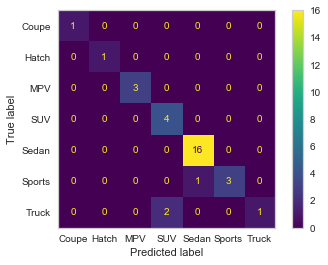

In [82]:
plot_confusion_matrix(classifier2 , x2_test, y2_test, cmap = 'viridis')  
plt.grid(None)
plt.show()

The accuracy of the classifier is 0.90625 and the weighted average precision, recall and f1-score are *0.9289, 0.90625, 0.895* respectively. This indicates that this model is a well developed model as it predicts most vehicles addtional class correctly.

In [83]:
fn=['Horsepower', 'Height', 'Curb_weight',  'Volume']
cn=['Coupe','Hatch', 'MPV', 'SUV', 'Sedan','Sports', 'Truck']
fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (25,25), dpi=1000)
plot_tree(classifier2,
               feature_names = fn, 
               class_names=cn,
               filled = True, fontsize = 5)
#May take a long time to run

[Text(11978.462837837838, 17931.25, 'Height <= 0.434\nentropy = 2.038\nsamples = 124\nvalue = [8, 3, 6, 20, 68, 14, 5]\nclass = Sedan'),
 Text(6152.871621621622, 16043.75, 'Height <= -0.677\nentropy = 1.278\nsamples = 94\nvalue = [8, 3, 0, 1, 68, 14, 0]\nclass = Sedan'),
 Text(2225.5067567567567, 14156.25, 'Height <= -0.976\nentropy = 1.418\nsamples = 22\nvalue = [2, 1, 0, 0, 5, 14, 0]\nclass = Sports'),
 Text(1701.8581081081081, 12268.75, 'entropy = 0.0\nsamples = 11\nvalue = [0, 0, 0, 0, 0, 11, 0]\nclass = Sports'),
 Text(2749.1554054054054, 12268.75, 'Horsepower <= -1.025\nentropy = 1.79\nsamples = 11\nvalue = [2, 1, 0, 0, 5, 3, 0]\nclass = Sedan'),
 Text(1047.2972972972973, 10381.25, 'Volume <= -1.141\nentropy = 0.811\nsamples = 4\nvalue = [0, 1, 0, 0, 3, 0, 0]\nclass = Sedan'),
 Text(523.6486486486486, 8493.75, 'entropy = 0.0\nsamples = 1\nvalue = [0, 1, 0, 0, 0, 0, 0]\nclass = Hatch'),
 Text(1570.9459459459458, 8493.75, 'entropy = 0.0\nsamples = 3\nvalue = [0, 0, 0, 0, 3, 0, 0]\n

Similiar to the previous task, the decision tree graph is too big to be analysed and cannot be understood clearly.
Therefore, the class prediction error for the classifier is plotted.

C:\Users\candy\Anaconda3\lib\site-packages\sklearn\base.py:197: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


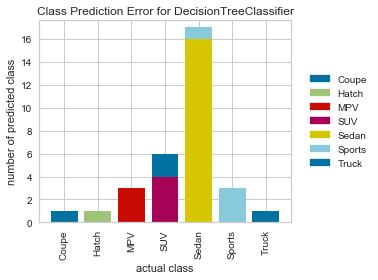

In [84]:
# Instantiate the classification model and visualizer
classes = ['Coupe','Hatch', 'MPV', 'SUV', 'Sedan','Sports', 'Truck']
visualizer = ClassPredictionError(classifier2, classes=classes)

# Fit the training data to the visualizer
visualizer.fit(x2_train, y2_train)

# Evaluate the model on the test data
visualizer.score(x2_test, y2_test)

# Draw visualization
visualizer.show()

The classifier predicts most vehicle alt class correctly but it sometimes mistakes *Truck* as *SUV* and *Sports* car as *Sedan*. This causes the precision and recall to decrease slightly but as the decrease is not significant, it is assumed that this model can predict vehicle_alt_class with a high accuracy with little mistakes.

# Conclusion

### Random Forest Classification

In [85]:
x3 = df1.iloc[:,[6,7,8,9,10,11,14,15,16]].values 
#Input Data : Horsepower, Wheelbase, Width,Length, Height, Curb Weight, Power Output per litre, Total distance travelled, Volume
y3 = df1.iloc[:,2].values # Labelled Data : Vehicle Class

In [86]:
x3_train, x3_test, y3_train, y3_test = train_test_split(
    x3, y3, test_size = 0.15, random_state = 0
)

In [87]:
x3_train = sc.fit_transform(x3_train)
x3_test = sc.transform(x3_test)

In [88]:
# Fitting Random Forest Classification to the Training set
from sklearn.ensemble import RandomForestClassifier
classifier3 = RandomForestClassifier(
n_estimators = 40,
criterion = 'entropy',
random_state = 0
)
classifier3.fit(x3_train, y3_train)
# Predicting the Test set results
y3_pred = classifier3.predict(x3_test)
# Making the Confusion Matrix
from sklearn.metrics import confusion_matrix
cm4 = confusion_matrix(y3_test, y3_pred)
cm4


array([[ 2,  0,  0,  1,  0],
       [ 0,  3,  0,  0,  0],
       [ 0,  0,  2,  0,  0],
       [ 0,  0,  0, 13,  0],
       [ 0,  0,  2,  0,  1]], dtype=int64)

In [89]:
classification_report(y1_test, y3_pred,output_dict=True)

{'Coupe': {'precision': 1.0,
  'recall': 0.6666666666666666,
  'f1-score': 0.8,
  'support': 3},
 'MPV': {'precision': 1.0, 'recall': 1.0, 'f1-score': 1.0, 'support': 3},
 'SUV': {'precision': 0.5,
  'recall': 1.0,
  'f1-score': 0.6666666666666666,
  'support': 2},
 'Sedan': {'precision': 0.9285714285714286,
  'recall': 1.0,
  'f1-score': 0.962962962962963,
  'support': 13},
 'Truck': {'precision': 1.0,
  'recall': 0.3333333333333333,
  'f1-score': 0.5,
  'support': 3},
 'accuracy': 0.875,
 'macro avg': {'precision': 0.8857142857142858,
  'recall': 0.8,
  'f1-score': 0.7859259259259259,
  'support': 24},
 'weighted avg': {'precision': 0.9196428571428571,
  'recall': 0.875,
  'f1-score': 0.8646604938271606,
  'support': 24}}

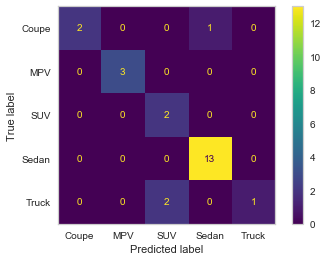

In [90]:
plot_confusion_matrix(classifier3 , x3_test, y3_test, cmap = 'viridis')  
plt.grid(None)
plt.show()

The ***accuracy*** for this classifier is *0.875*, weighted averaged ***precision,recall and f1-score*** of this classifier are *0.92, 0.875 and 0.865*. The accuracy, precision, recall and f1-score are all considerably high which means most instances are classified into the correct class. There exists some cases of false negative and false positive but as it do not significantly affect the performance of the model, the model is evaluated to be a good model

In [91]:
fn=['Horsepower', 'Wheelbase', 'Width' ,'Length','Height', 'Curb_weight', 'Power Output per litre', 
    'Total distance Travelled', 'Volume']
cn=['Coupe', 'MPV', 'SUV', 'Sedan', 'Truck']
fig, axes = plt.subplots(nrows = 5,ncols = 1,figsize = (10,50), dpi=1000)
for index in range(0, 5):
    plot_tree(classifier3.estimators_[index],
                   feature_names = fn, 
                   class_names=cn,
                   filled = True,
                   ax = axes[index]);
    
    axes[index].set_title('Estimator: ' + str(index), fontsize = 20)

Only 5 estimators of the random forest classifier are shown, as it will be time consuming and hard to analyse 40 estimators. Moreover, the the tree graphs for 5 estimators are hard to see and understand as it contains too many information. To simplify this, another grahical chart on the class prediction error is shown below for easy understanding.

C:\Users\candy\Anaconda3\lib\site-packages\sklearn\base.py:197: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


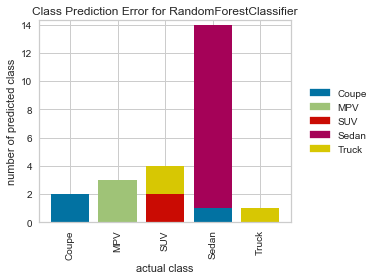

In [92]:
# Instantiate the classification model and visualizer
classes = ['Coupe', 'MPV', 'SUV', 'Sedan', 'Truck']
visualizer = ClassPredictionError(classifier3, classes=classes)

# Fit the training data to the visualizer
visualizer.fit(x3_train, y3_train)

# Evaluate the model on the test data
visualizer.score(x3_test, y3_test)

# Draw visualization
visualizer.show()

Based on the graph above, similiarly to the decision tree classifier, the random forest classifier mostly predicts the vehicles correctly according to its vehicle class. However, this classifier often mistakes *Truck* as *SUV* and *Coupe* as *Sedan*.

## Summary

From clustering, it is possible to look at the relationship between the variables and hidden pattern in the data in which useful data can be extracted to understand the dataset better. However, clustering 2 variables may not always gives an obvious pattern or relationship. Therefore, a different set of inputs were clustered, and showed a more defined pattern and information. It is hard to evaluate the performance of the clustering model as there is no definite test to test the model. Therefore, the evaluation has to be based on intuition and interpretation to find out similiarity between the data.

As the number of input data chosen increases, it causes the depth of the decision tree classifier and random forest classifier to increase as the model need to consider more features to get the output. Also, it was noticed that for multi-class classification, the accuracy, recall, precision increases when the number of input data increases, but the input data must have a significant feature importance to the model. Although a 'perfect' model has been built for binary classification, it was not the same case for multi class classification. Although both models for multi class classification has considerably high accuracy, recall and precision, errors still occurred during the classification. This could be due to the increase of categories in the labelled data where some categories shared similiar features or atrributes that cause the model the wrongly classified the vehicle.

Random Forest Algorithm was used to build a model to predict vehicle class which is the same labelled data as question 3(d) which used decision tree algorithm to build the model. Although both models were built using different algorithms, both of them produced the same confusion matrix and same output when tested with the same test data and when trained using same input data.

### Kaggle Test Data Prediction

In [93]:
test_data = pd.read_csv('kaggle-test-data.csv')

In [94]:
test_data

,Id,Engine_size (litres),Horsepower,Wheelbase,Width,Length,Height,Curb_weight,Fuel_capacity,Fuel_efficiency
0,1,2.5,189,102.2,68.7,174.4,55.7,2.987,16.6,26.0
1,2,6.0,420,102.0,72.0,183.7,48.7,3.924,23.5,15.0
2,3,4.4,282,117.1,78.9,194.3,68.7,4.813,24.6,14.0
3,4,2.5,170,96.3,68.5,159.4,50.9,2.899,13.5,24.8
4,5,3.8,180,119.3,76.8,199.7,68.7,4.045,20.0,17.0
5,6,5.0,268,110.0,73.6,193.2,56.6,3.373,18.0,27.5
6,7,3.8,203,109.8,72.5,192.2,57.1,3.507,19.8,26.7
7,8,3.5,205,114.4,71.7,196.7,56.3,3.715,18.0,19.3
8,9,6.0,543,104.3,80.3,176.0,43.5,3.583,26.4,10.5
9,10,2.5,120,110.0,70.5,181.1,81.1,4.531,25.5,21.2


In [95]:
test_data['Power Ouptut per litre'] = test_data['Horsepower']/test_data['Engine_size (litres)']

In [96]:
test_data['Total distance Travelled'] = test_data['Fuel_capacity'] * test_data['Fuel_efficiency']

In [97]:
test_data['Volume'] = test_data['Width'] * test_data['Length'] * test_data['Height']

In [98]:
x5 = test_data.iloc[:,[2,3,4,5,6,7,10,11,12]].values

In [99]:
x5 = sc.fit_transform(x5)

In [100]:
y_pred_test = classifier1.predict(x5)

In [101]:
y_pred_test

array(['Sedan', 'Coupe', 'SUV', 'Coupe', 'MPV', 'Sedan', 'Sedan', 'Sedan',
       'Coupe', 'SUV', 'SUV', 'SUV', 'Sedan', 'Sedan', 'Sedan', 'Sedan',
       'SUV'], dtype=object)

In [102]:
#output the results into a csv file
lst = list(range(1,18))
# dictionary of lists
kaggle = { 'Id' : lst, 'Predicted': y_pred_test}
df6 = pd.DataFrame(kaggle)  
df6.to_csv('result.csv', index = False) 